In [3]:
library(mice)
library(finalfit)
library(ggplot2)
library(dplyr)
library(stats)
library(miceadds)
library(missMethods)
library(smotefamily)
library(caret)
library(cowplot)
library(mlr)
library(fastDummies)
library(DMwR2)
library(mlmi)
library(ranger)
library(scales)

Warning message:
"pakiet 'mice' został zbudowany w wersji R 4.3.2"



Dołączanie pakietu: 'mice'


Następujący obiekt został zakryty z 'package:stats':

    filter


Następujące obiekty zostały zakryte z 'package:base':

    cbind, rbind


Warning message:
"pakiet 'ggplot2' został zbudowany w wersji R 4.3.3"

Dołączanie pakietu: 'dplyr'


Następujące obiekty zostały zakryte z 'package:stats':

    filter, lag


Następujące obiekty zostały zakryte z 'package:base':

    intersect, setdiff, setequal, union


* miceadds 3.16-18 (2023-01-06 10:54:00)

Ładowanie wymaganego pakietu: lattice

Warning message:
"pakiet 'cowplot' został zbudowany w wersji R 4.3.2"
Warning message:
"pakiet 'mlr' został zbudowany w wersji R 4.3.2"
Ładowanie wymaganego pakietu: ParamHelpers

Warning message:
"pakiet 'ParamHelpers' został zbudowany w wersji R 4.3.2"
Warning message: 'mlr' is in 'maintenance-only' mode since July 2019.
Future development will only happen in 'mlr3'
(<https://mlr3.mlr-org.com>). Due to the focus on 'mlr3' there might be
uncaught bugs meanwhile in {mlr} 

In [4]:
visImpCont <- function(orig_train, orig_test, imp_train, imp_test, miss_var, imp_type) {
    #' Visualize imputation of missing data for continuous variable.

    orig_data <- rbind(orig_train, orig_test)
    orig_data <- orig_data[order(orig_data$index),]
    imp_data <- rbind(imp_train, imp_test)
    imp_data <- imp_data[order(imp_data$index),]

    miss_ind <- which(is.na(orig_data[[miss_var]]))
    imp_data$imputed <- "Observed"
    imp_data$imputed[miss_ind] <- "Imputed"

    ggplot(data = imp_data, aes(x = index, y = !!as.name(miss_var), color = imputed)) +
        geom_point(data = subset(imp_data, imputed == "Observed"), size = 3, alpha = 0.8) +
        geom_point(data = subset(imp_data, imputed == "Imputed"), size = 3) +
        scale_color_manual(values = c("steelblue1", "royalblue4")) +
        ggtitle(paste(miss_var, imp_type, "imputation")) +
        theme(
            plot.title = element_text(size = 26),
            axis.title = element_text(size = 22),         
            axis.text.x = element_text(size = 18),        
            axis.text.y = element_text(size = 18),
            legend.text = element_text(size = 16),        
            legend.title = element_text(size = 18))
}

In [5]:
visImpCat <- function(orig_train, orig_test, imp_train, imp_test, miss_var, imp_type) {
    #' Visualize imputation of missing data for categorical variable.

    orig_data <- rbind(orig_train, orig_test)
    orig_data <- orig_data[order(orig_data$index),]
    imp_data <- rbind(imp_train, imp_test)
    imp_data <- imp_data[order(imp_data$index),]

    miss_ind <- which(is.na(orig_data[[miss_var]]))
    imp_data$imputed <- "Observed"
    imp_data$imputed[miss_ind] <- "Imputed"

    ggplot(data = imp_data, aes(x = !!as.name(miss_var), fill = imputed)) +
        geom_bar() +
        scale_fill_manual(values = c("steelblue1", "royalblue4")) +
        ggtitle(paste(miss_var, imp_type, "imputation")) +
        theme(
            plot.title = element_text(size = 26),
            axis.title = element_text(size = 22),         
            axis.text.x = element_text(size = 18),        
            axis.text.y = element_text(size = 18),
            legend.text = element_text(size = 16),        
            legend.title = element_text(size = 18))
}

In [6]:
visImpMul <- function(orig_train, orig_test, imp_train, imp_test, miss_var, imp_type) {
    #' Visualize imputation of missing data for continuous variable (multiple imputation).

    orig_data <- rbind(orig_train, orig_test)
    orig_data <- orig_data[order(orig_data$index),]
    imp_data <- rbind(imp_train, imp_test)
    imp_data <- imp_data[order(imp_data$index),]

    miss_ind <- which(is.na(orig_data[[miss_var]]))
    imp_data$imputed <- "Observed"
    imp_data$imputed[miss_ind] <- "Imputed"

    p <- ggplot(data = imp_data, aes(x = index, y = !!as.name(miss_var), color = imputed)) +
        geom_point(data = subset(imp_data, imputed == "Observed"), size = 3, alpha = 0.8) +
        geom_point(data = subset(imp_data, imputed == "Imputed"), size = 3) +
        scale_color_manual(values = c("steelblue1", "royalblue4")) +
        ggtitle(paste(miss_var, imp_type, "imputation")) +
        theme(
            plot.title = element_text(size = 26),
            axis.title = element_text(size = 22),         
            axis.text.x = element_text(size = 18),        
            axis.text.y = element_text(size = 18),
            legend.text = element_text(size = 16),        
            legend.title = element_text(size = 18),
            strip.text = element_text(size = 18))

    p + facet_wrap(~ .imp, ncol = 2, scales="free")
}

In [7]:
visImpMulCat <- function(orig_train, orig_test, imp_train, imp_test, miss_var, imp_type) {
    #' Visualize imputation of missing data for categorical variable (multiple imputation).

    orig_data <- rbind(orig_train, orig_test)
    orig_data <- orig_data[order(orig_data$index),]
    imp_data <- rbind(imp_train, imp_test)
    imp_data <- imp_data[order(imp_data$index),]

    miss_ind <- which(is.na(orig_data[[miss_var]]))
    imp_data$imputed <- "Observed"
    imp_data$imputed[miss_ind] <- "Imputed"

    p <- ggplot(data = imp_data, aes(x = !!as.name(miss_var), fill = imputed)) +
        geom_bar() +
        scale_fill_manual(values = c("steelblue1", "royalblue4")) +
        ggtitle(paste(miss_var, imp_type, "imputation")) +
        theme(
            plot.title = element_text(size = 26),
            axis.title = element_text(size = 22),         
            axis.text.x = element_text(size = 18),        
            axis.text.y = element_text(size = 18),
            legend.text = element_text(size = 16),        
            legend.title = element_text(size = 18),
            strip.text = element_text(size = 18))

    p + facet_wrap(~ .imp, ncol = 2, scales="free")
}

In [8]:
balancedTrain <- function(trainset, tgt_cls, fcols, multiple = FALSE) {
    #' Oversample minority class, return balanced training set.

    trainset <- dummy_cols(trainset, select_columns = fcols)
    trainset <- trainset[, !names(trainset) %in% fcols]
    
    if (multiple == TRUE) {
        trainset <- subset(trainset, select = -c(.imp))
    }
    
    feature_cols <- setdiff(colnames(trainset), tgt_cls)
    adas <- ADAS(trainset[, feature_cols], trainset[[tgt_cls]])
    balanced <- adas$data
    colnames(balanced)[colnames(balanced) == "class"] <- tgt_cls
    
    return (balanced)
}

In [9]:
numericTest <- function(testset, fcols) {
    #' Convert all categorical features in test set to numeric (except target class).

    testset <- dummy_cols(testset, select_columns = fcols)
    testset <- testset[, !names(testset) %in% fcols]
    
    return(testset)
}

In [10]:
scaleDataSet <- function(dataset, tgt_cls, multiple=FALSE) {
    #' Scale all data to [0, 1] range.

    tgt_class <- dataset[[tgt_cls]]

    if (multiple == TRUE) {
        imp_col <- dataset$.imp
        feature_cols <- setdiff(colnames(dataset), c(tgt_cls, ".imp"))
        data_cols <- dataset[, feature_cols]
        scaled_data <- as.data.frame(lapply(data_cols, FUN = rescale))
        scaled_data$.imp <- imp_col
        scaled_data[[tgt_cls]] <- tgt_class
    }
    else {
        feature_cols <- setdiff(colnames(dataset), tgt_cls)
        data_cols <- dataset[, feature_cols]
        scaled_data <- as.data.frame(lapply(data_cols, FUN = rescale))
        scaled_data[[tgt_cls]] <- tgt_class
    }

    return(scaled_data)
}

In [11]:
create_zero_df <- function(num_rows, num_cols, colnames) {
  #' Create dataframe of zeros.
  
  df <- as.data.frame(matrix(0, nrow = num_rows, ncol = num_cols))
  names(df) <- colnames
  return(df)
}

In [12]:
check_data <- function(data) {
  #' Check if data has any NA/NaN/Inf values.

  !any(sapply(data, function(x) any(is.na(x) | is.nan(x) | is.infinite(x))))
}

In [13]:
classify <- function(tgt_cls, balanced, numtest) {
    #' Apply the four classification algorithms.

    glm <- caret::train(as.formula(paste(tgt_cls, "~ .")), data = balanced, method = "glm")
    glm_pred <- predict(glm, newdata = numtest)

    knn_grid <- data.frame(k=seq(1, 10, by=1))
    knn_control <- trainControl(method = "cv", number = 5)
    knn <- caret::train(as.formula(paste(tgt_cls, "~ .")), data = balanced, method = "knn", trControl = knn_control, tuneGrid = knn_grid)
    knn_pred <- predict(knn, newdata = numtest)

    ct <- makeClassifTask(id = "mcar", data = balanced, target = tgt_cls)
    cv <- makeResampleDesc("CV", iters = 5)
    lrn <- makeLearner("classif.rpart")
    cg <- makeTuneControlGrid()
    ps <- makeParamSet(
    makeDiscreteParam("cp", values = seq(0.01, 0.6, by = 0.1)),
    makeDiscreteParam("minbucket", values = c(3, 7, 10)),
    makeDiscreteParam("maxdepth", values = seq(5, 30, by = 5)))
    tunedt <- tuneParams(lrn, task = ct, resampling = cv, control = cg, par.set = ps, measures = acc)
    dtparams <- tunedt$x
    opt_lrn <- setHyperPars(lrn, par.vals = dtparams)
    dt <- mlr::train(opt_lrn, ct)
    dt_pred <- predict(dt, newdata = numtest)$data$response

    rf_grid <- expand.grid(mtry = seq(1, 15))
    rf_control <- trainControl(method ="cv", number=5)
    rf <- caret::train(as.formula(paste(tgt_cls, "~ .")), data = balanced, method = "rf", trControl = rf_control, tuneGrid = rf_grid, ntree=100)
    rf_pred <- predict(rf, newdata = numtest)

    return(list(glm_pred=glm_pred, knn_pred=knn_pred, dt_pred=dt_pred, rf_pred=rf_pred))
}

In [14]:
simulate <- function(dataset, tgt_cls, nsim, method, m, maxit, filename, intcols, fcols) {
    #' Simulate classification on data imputed with mice package methods.

    predm <- make.predictorMatrix(dataset)
    res <- create_zero_df(nsim, 4, c("glm", "knn", "dt", "rf"))
    filecon <- file(filename, "w")
    on.exit({close(filecon)}, add = TRUE)
    
    for (n in 1:nsim) {

        good_test <- FALSE
        good_data <- FALSE
        good_pred <- FALSE
 
        if (m==1) {

            while (!good_pred) {

                while (!(good_test && good_data)) {
                    train_ind <- createDataPartition(dataset[[tgt_cls]], p = 0.75, list = FALSE)
                    train <- dataset[train_ind,]
                    test  <- dataset[-train_ind,]
                    imp_train <- mice(train, method=method, m=m, maxit=maxit, predictorMatrix=predm) %>% complete()
                    imp_test <- mice(test, method=method, m=m, maxit=maxit, predictorMatrix=predm) %>% complete()
                    good_test <- length(unique(imp_test[[tgt_cls]])) == 2

                    balanced <- balancedTrain(imp_train, tgt_cls, fcols)
                    numtest <- numericTest(imp_test, fcols)
                    balanced[intcols] <- balanced[intcols] %>% lapply(as.integer)
                    balanced <- scaleDataSet(balanced, tgt_cls)
                    numtest <- scaleDataSet(numtest, tgt_cls)
                    good_data <- (check_data(balanced) && check_data(numtest))
                }

                preds <- classify(tgt_cls, balanced, numtest)
                good_glm <- length(unique(preds$glm_pred)) == 2
                good_knn <- length(unique(preds$knn_pred)) == 2
                good_dt <- length(unique(preds$dt_pred)) == 2
                good_rf <- length(unique(preds$rf_pred)) == 2
                good_pred <- good_glm && good_knn && good_dt && good_rf
                good_data <- FALSE
                good_test <- FALSE
            }

            glm_cm <- confusionMatrix(numtest[[tgt_cls]], preds$glm_pred)
            res[n, 1] <- as.numeric(glm_cm$overall[1])

            knn_cm <- confusionMatrix(numtest[[tgt_cls]], preds$knn_pred)
            res[n, 2] <- as.numeric(knn_cm$overall[1])

            dt_cm <- confusionMatrix(numtest[[tgt_cls]], preds$dt_pred)
            res[n, 3] <- as.numeric(dt_cm$overall[1])

            rf_cm <- confusionMatrix(numtest[[tgt_cls]], preds$rf_pred)
            res[n, 4] <- as.numeric(rf_cm$overall[1])

            write.table(res[n, ], filecon, sep = ",", row.names = FALSE, col.names = FALSE, append = TRUE)
            flush(filecon)

        }
        else {
            glm_pred <- list()
            knn_pred <- list()
            dt_pred <- list()
            rf_pred <- list()

            while (!good_pred) {

                while (!(good_test && good_data)) {
                    train_ind <- createDataPartition(dataset[[tgt_cls]], p = 0.75, list = FALSE)
                    train <- dataset[train_ind,]
                    test  <- dataset[-train_ind,]
                    imp_train <- mice(train, method=method, m=m, maxit=maxit, predictorMatrix=predm) %>% complete(action="long")
                    imp_test <- mice(test, method=method, m=m, maxit=maxit, predictorMatrix=predm) %>% complete(action="long")
                    good_test <- length(unique(imp_test[[tgt_cls]])) == 2

                    balanced <- balancedTrain(subset(imp_train, .imp == 1), tgt_cls, fcols)
                    balanced$.imp <- 1
                    numtest <- numericTest(imp_test, fcols)
                    numtest <- scaleDataSet(numtest, tgt_cls, multiple=TRUE)
                    tst <- subset(numtest, .imp == 1)

                    for (i in 2:m) {
                        imptr <- subset(imp_train, .imp == i)
                        btr <- balancedTrain(imptr, tgt_cls, fcols)
                        btr$.imp <- i
                        balanced <- rbind(balanced, btr)
                    }

                    balanced[intcols] <- balanced[intcols] %>% lapply(as.integer)
                    balanced <- scaleDataSet(balanced, tgt_cls, multiple=TRUE)
                    good_data <- (check_data(balanced) && check_data(numtest))
                }

                for (i in 1:m) {
                    trn <- subset(balanced, .imp == i)
                    preds <- classify(tgt_cls, trn, tst)
                    glm_pred[[i]] <- preds$glm_pred
                    knn_pred[[i]] <- preds$knn_pred
                    dt_pred[[i]] <- preds$dt_pred
                    rf_pred[[i]] <- preds$rf_pred
                }

                glm_pred <- lapply(glm_pred, function(x) as.numeric(as.character(x)))
                mv_glm <- as.factor(as.integer(colMeans(do.call(rbind, glm_pred)) > 0.5))
                good_glm <- length(unique(mv_glm)) == 2

                knn_pred <- lapply(knn_pred, function(x) as.numeric(as.character(x)))
                mv_knn <- as.factor(as.integer(colMeans(do.call(rbind, knn_pred)) > 0.5))
                good_knn <- length(unique(mv_knn)) == 2

                dt_pred <- lapply(dt_pred, function(x) as.numeric(as.character(x)))
                mv_dt <- as.factor(as.integer(colMeans(do.call(rbind, dt_pred)) > 0.5))
                good_dt <- length(unique(mv_dt)) == 2

                rf_pred <- lapply(rf_pred, function(x) as.numeric(as.character(x)))
                mv_rf <- as.factor(as.integer(colMeans(do.call(rbind, rf_pred)) > 0.5))
                good_rf <- length(unique(mv_rf)) == 2

                good_pred <- good_glm && good_knn && good_dt && good_rf
                good_data <- FALSE
                good_test <- FALSE 
            }

            glm_cm <- confusionMatrix(tst[[tgt_cls]], mv_glm)
            res[n, 1] <- as.numeric(glm_cm$overall[1])
            
            knn_cm <- confusionMatrix(tst[[tgt_cls]], mv_knn)
            res[n, 2] <- as.numeric(knn_cm$overall[1])

            dt_cm <- confusionMatrix(tst[[tgt_cls]], mv_dt)
            res[n, 3] <- as.numeric(dt_cm$overall[1])

            rf_cm <- confusionMatrix(tst[[tgt_cls]], mv_rf)
            res[n, 4] <- as.numeric(rf_cm$overall[1])

            write.table(res[n, ], filecon, sep = ",", row.names = FALSE, col.names = FALSE, append = TRUE)
            flush(filecon)
        }
    }

    return(colMeans(res))
}

In [15]:
simulate_knn <- function(dataset, tgt_cls, nsim, filename, intcols, fcols) {
    #' Simulate classification on data imputed with KNN.

    res <- create_zero_df(nsim, 4, c("glm", "knn", "dt", "rf"))
    filecon <- file(filename, "w")
    on.exit({close(filecon)}, add = TRUE)

    for (n in 1:nsim) {

        good_test <- FALSE
        good_data <- FALSE
        good_pred <- FALSE

        while(!good_pred) {

            while (!(good_test && good_data)) {
                train_ind <- createDataPartition(dataset[[tgt_cls]], p = 0.75, list = FALSE)
                train <- dataset[train_ind,]
                test  <- dataset[-train_ind,]
                imp_train <- knnImputation(train, scale=FALSE)
                imp_test <- knnImputation(test, scale=FALSE)
                good_test <- length(unique(imp_test[[tgt_cls]])) == 2

                balanced <- balancedTrain(imp_train, tgt_cls, fcols)
                numtest <- numericTest(imp_test, fcols)
                balanced[intcols] <- balanced[intcols] %>% lapply(as.integer)
                balanced <- scaleDataSet(balanced, tgt_cls)
                numtest <- scaleDataSet(numtest, tgt_cls)
                good_data <- (check_data(balanced) && check_data(numtest))          
            }

            preds <- classify(tgt_cls, balanced, numtest)
            good_glm <- length(unique(preds$glm_pred)) == 2
            good_knn <- length(unique(preds$knn_pred)) == 2
            good_dt <- length(unique(preds$dt_pred)) == 2
            good_rf <- length(unique(preds$rf_pred)) == 2
            good_pred <- good_glm && good_knn && good_dt && good_rf
            good_data <- FALSE
            good_test <- FALSE
        }

        glm_cm <- confusionMatrix(numtest[[tgt_cls]], preds$glm_pred)
        res[n, 1] <- as.numeric(glm_cm$overall[1])

        knn_cm <- confusionMatrix(numtest[[tgt_cls]], preds$knn_pred)
        res[n, 2] <- as.numeric(knn_cm$overall[1])

        dt_cm <- confusionMatrix(numtest[[tgt_cls]], preds$dt_pred)
        res[n, 3] <- as.numeric(dt_cm$overall[1])

        rf_cm <- confusionMatrix(numtest[[tgt_cls]], preds$rf_pred)
        res[n, 4] <- as.numeric(rf_cm$overall[1])

        write.table(res[n, ], filecon, sep = ",", row.names = FALSE, col.names = FALSE, append = TRUE)
        flush(filecon)
    }

    return(colMeans(res))
}

In [16]:
simulate_mlmi <- function(dataset, tgt_cls, nsim, m, filename, intcols, fcols, fcols_class) {
    #' Simulate classification on data imputed with MLMI.

    res <- create_zero_df(nsim, 4, c("glm", "knn", "dt", "rf"))
    filecon <- file(filename, "w")
    on.exit({close(filecon)}, add = TRUE)

    for (n in 1:nsim) {

        good_test <- FALSE
        good_data <- FALSE
        good_pred <- FALSE

        while(!good_pred) {

            while (!(good_test && good_data)) {
                train_ind <- createDataPartition(dataset[[tgt_cls]], p = 0.75, list = FALSE)
                train <- dataset[train_ind,]
                test  <- dataset[-train_ind,]

                cattrain <- train[, (names(train) %in% fcols_class)]
                cattest <- test[, (names(test) %in% fcols_class)]
                conttrain <- train[, !(names(train) %in% colnames(cattrain))]
                conttest <- test[, !(names(test) %in% colnames(cattest))]

                train <- cbind(cattrain, conttrain)
                test <- cbind(cattest, conttest)
                train[] <- lapply(train, function(x) if(is.factor(x)) as.integer(x) else x)
                test[] <- lapply(test, function(x) if(is.factor(x)) as.integer(x) else x)

                imp_train <- mixImp(obsData = train, nCat = 8, M = m, rseed = 1234)
                imp_test <- mixImp(obsData = test, nCat = 8, M = m, rseed = 1234)

                imp_train_df <- imp_train[[1]]
                imp_test_df <- imp_test[[1]]
                imp_train_df$.imp <- 1
                imp_test_df$.imp <- 1

                for (i in 2:m) {
                    imp_train_i <- imp_train[[i]]
                    imp_train_i$.imp <- i
                    imp_train_df <- rbind(imp_train_df, imp_train_i)

                    imp_test_i <- imp_test[[i]]
                    imp_test_i$.imp <- i
                    imp_test_df <- rbind(imp_test_df, imp_test_i)
                }

                imp_train_df[fcols_class] <- imp_train_df[fcols_class] %>% lapply(factor)
                imp_test_df[fcols_class] <- imp_test_df[fcols_class] %>% lapply(factor)

                for (col in fcols_class) {
                    imp_train_df[[col]] <- ifelse(imp_train_df[[col]] == 1, levels(dataset[[col]])[1], levels(dataset[[col]])[2])
                    imp_test_df[[col]] <- ifelse(imp_test_df[[col]] == 1, levels(dataset[[col]])[1], levels(dataset[[col]])[2])
                }

                imp_train_df[fcols_class] <- imp_train_df[fcols_class] %>% lapply(factor)
                imp_test_df[fcols_class] <- imp_test_df[fcols_class] %>% lapply(factor)
                imp_train_df[intcols] <- imp_train_df[intcols] %>% lapply(as.integer)
                imp_test_df[intcols] <- imp_test_df[intcols] %>% lapply(as.integer)

                good_test <- length(unique(imp_test_df[[tgt_cls]])) == 2
                
                balanced <- balancedTrain(subset(imp_train_df, .imp == 1), tgt_cls, fcols)
                balanced$.imp <- 1
                numtest <- numericTest(imp_test_df, fcols)
                numtest <- scaleDataSet(numtest, tgt_cls, multiple=TRUE)
                tst <- subset(numtest, .imp == 1)

                for (i in 2:m) {
                    imptr <- subset(imp_train_df, .imp == i)
                    btr <- balancedTrain(imptr, tgt_cls, fcols)
                    btr$.imp <- i
                    balanced <- rbind(balanced, btr)
                }

                balanced[intcols] <- balanced[intcols] %>% lapply(as.integer)
                balanced <- scaleDataSet(balanced, tgt_cls, multiple=TRUE)

                good_data <- (check_data(balanced) && check_data(numtest))             
            }

            glm_pred <- list()
            knn_pred <- list()
            dt_pred <- list()
            rf_pred <- list()

            for (i in 1:m) {
                trn <- subset(balanced, .imp == i)
                preds <- classify(tgt_cls, trn, tst)
                glm_pred[[i]] <- preds$glm_pred
                knn_pred[[i]] <- preds$knn_pred
                dt_pred[[i]] <- preds$dt_pred
                rf_pred[[i]] <- preds$rf_pred
            }

            glm_pred <- lapply(glm_pred, function(x) as.numeric(as.character(x)))
            mv_glm <- as.factor(as.integer(colMeans(do.call(rbind, glm_pred)) > 0.5))
            good_glm <- length(unique(mv_glm)) == 2

            knn_pred <- lapply(knn_pred, function(x) as.numeric(as.character(x)))
            mv_knn <- as.factor(as.integer(colMeans(do.call(rbind, knn_pred)) > 0.5))
            good_knn <- length(unique(mv_knn)) == 2

            dt_pred <- lapply(dt_pred, function(x) as.numeric(as.character(x)))
            mv_dt <- as.factor(as.integer(colMeans(do.call(rbind, dt_pred)) > 0.5))
            good_dt <- length(unique(mv_dt)) == 2

            rf_pred <- lapply(rf_pred, function(x) as.numeric(as.character(x)))
            mv_rf <- as.factor(as.integer(colMeans(do.call(rbind, rf_pred)) > 0.5))
            good_rf <- length(unique(mv_rf)) == 2

            good_pred <- good_glm && good_knn && good_dt && good_rf
            good_data <- FALSE
            good_test <- FALSE
        }

        glm_cm <- confusionMatrix(tst[[tgt_cls]], mv_glm)
        res[n, 1] <- as.numeric(glm_cm$overall[1])

        knn_cm <- confusionMatrix(tst[[tgt_cls]], mv_knn)
        res[n, 2] <- as.numeric(knn_cm$overall[1])

        dt_cm <- confusionMatrix(tst[[tgt_cls]], mv_dt)
        res[n, 3] <- as.numeric(dt_cm$overall[1])

        rf_cm <- confusionMatrix(tst[[tgt_cls]], mv_rf)
        res[n, 4] <- as.numeric(rf_cm$overall[1])

        write.table(res[n, ], filecon, sep = ",", row.names = FALSE, col.names = FALSE, append = TRUE)
        flush(filecon)
    }

    return(colMeans(res))
}

In [17]:
hep <- read.csv("hepatitis_cat.csv")
fcols <- c("male", "steroid", "antivirals", "fatigue", "malaise", "anorexia", "liver_big", 
            "liver_firm", "spleen_palpable", "spiders", "ascites", "varices", "histology", "die")
fcols2 <- c("male", "steroid", "antivirals", "fatigue", "malaise", "anorexia", "liver_big", 
            "liver_firm", "spleen_palpable", "spiders", "ascites", "varices", "histology")
intcols <- c("alk_phosphate", "age", "sgot", "protime")            
hep[fcols] <- hep[fcols] %>% lapply(factor)

In [18]:
hep_vis <- hep
hep_vis$index <- as.numeric(row.names(hep_vis))

In [19]:
set.seed(1234)
train_ind <- createDataPartition(hep_vis$die, p = 0.75, list = FALSE)
train <- hep_vis[train_ind,]
test  <- hep_vis[-train_ind,]

In [20]:
predm <- make.predictorMatrix(hep_vis)
predm[,"index"] <- 0

##### Logistic regression imputation

In [21]:
train1 <- train
test1 <- test
method1 <- rep("", ncol(hep_vis))
method1[c(2, 7, 8, 9, 10, 11, 12)] <- "logreg"

In [22]:
imp_train1 <- mice(train1, method=method1, predictorMatrix=predm, m=1, maxit=1) %>% complete()


 iter imp variable
  1   1  steroid  liver_big  liver_firm  spleen_palpable  spiders  ascites  varices


In [23]:
imp_test1 <- mice(test1, method=method1, predictorMatrix=predm, m=1, maxit=1) %>% complete()


 iter imp variable
  1   1  liver_big  liver_firm

Warning message:
"glm.fit: algorytm nie zbiegł się"


  spleen_palpable

Warning message:
"glm.fit: algorytm nie zbiegł się"


  spiders

Warning message:
"glm.fit: algorytm nie zbiegł się"


  ascites  varices


In [24]:
imp_train1[intcols] <- imp_train1[intcols] %>% lapply(as.integer)
imp_test1[intcols] <- imp_test1[intcols] %>% lapply(as.integer)

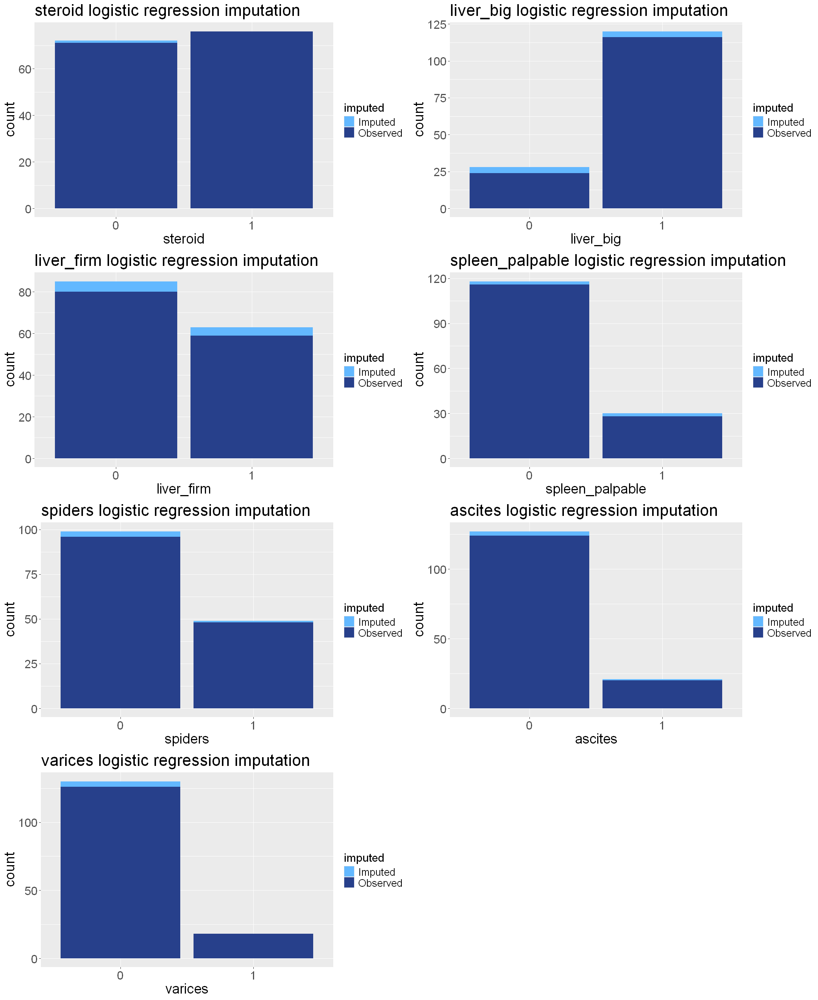

In [25]:
options(repr.plot.width = 18, repr.plot.height = 22)
plt1 <- visImpCat(train1, test1, imp_train1, imp_test1, "steroid", "logistic regression")
plt2 <- visImpCat(train1, test1, imp_train1, imp_test1, "liver_big", "logistic regression")
plt3 <- visImpCat(train1, test1, imp_train1, imp_test1, "liver_firm", "logistic regression")
plt4 <- visImpCat(train1, test1, imp_train1, imp_test1, "spleen_palpable", "logistic regression")
plt5 <- visImpCat(train1, test1, imp_train1, imp_test1, "spiders", "logistic regression")
plt6 <- visImpCat(train1, test1, imp_train1, imp_test1, "ascites", "logistic regression")
plt7 <- visImpCat(train1, test1, imp_train1, imp_test1, "varices", "logistic regression")
plot_grid(plt1, plt2, plt3, plt4, plt5, plt6, plt7, ncol = 2)

In [21]:
method1_cls <- rep("", ncol(hep))
method1_cls[c(2, 7, 8, 9, 10, 11, 12)] <- "logreg"

In [22]:
sim1 <- simulate(hep, "die", 100, method1_cls, 1, 1, "logreg.csv", intcols, fcols2)


 iter imp variable
  1   1  steroid  liver_big  liver_firm  spleen_palpable  spiders  ascites  varices

 iter imp variable
  1   1  liver_big  liver_firm  spleen_palpable  spiders

Warning message:
"glm.fit: algorytm nie zbiegł się"


  ascites  varices


Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numeryczni

In [32]:
sim1

V1        V2        V3        V4 
0.8102778 0.7594444 0.7647222 0.8327778

##### KNN imputation

In [26]:
train8 <- train
imp_train8 <- knnImputation(train8, scale=FALSE)

In [27]:
test8 <- test
imp_test8 <- knnImputation(test8, scale=FALSE)

In [28]:
intcols <- c("alk_phosphate", "age", "sgot", "protime")
imp_train8[intcols] <- imp_train8[intcols] %>% lapply(as.integer)
imp_test8[intcols] <- imp_test8[intcols] %>% lapply(as.integer)

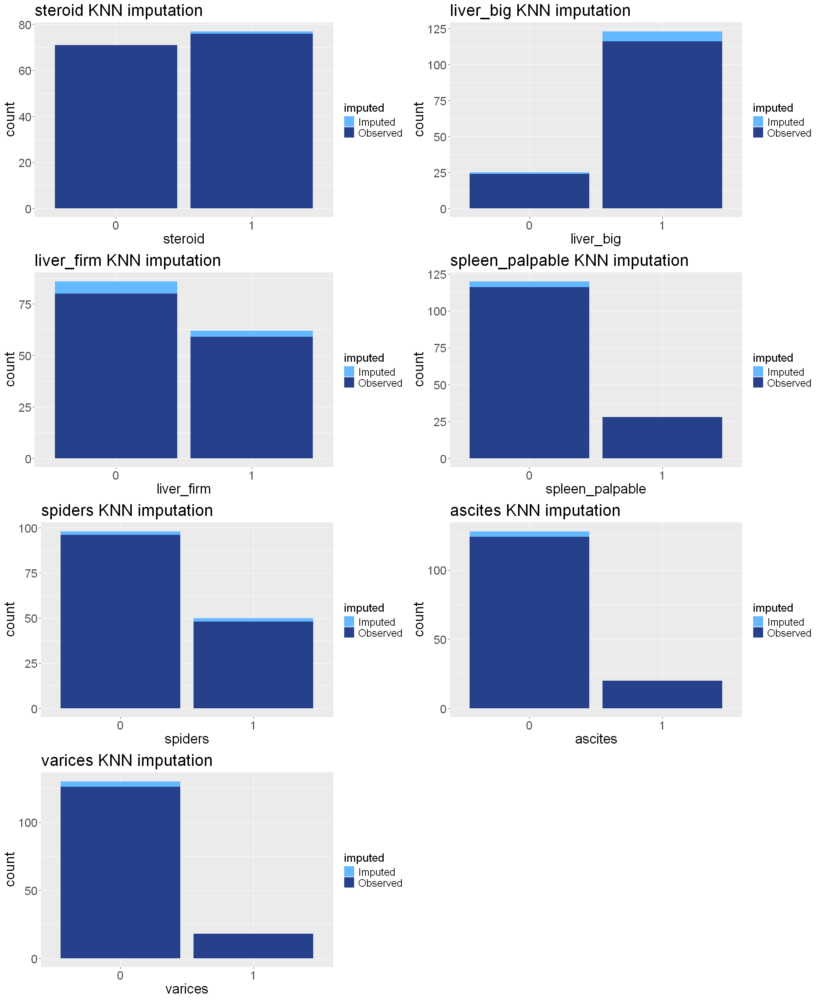

In [29]:
options(repr.plot.width = 18, repr.plot.height = 22)
plt1 <- visImpCat(train8, test8, imp_train8, imp_test8, "steroid", "KNN")
plt2 <- visImpCat(train8, test8, imp_train8, imp_test8, "liver_big", "KNN")
plt3 <- visImpCat(train8, test8, imp_train8, imp_test8, "liver_firm", "KNN")
plt4 <- visImpCat(train8, test8, imp_train8, imp_test8, "spleen_palpable", "KNN")
plt5 <- visImpCat(train8, test8, imp_train8, imp_test8, "spiders", "KNN")
plt6 <- visImpCat(train8, test8, imp_train8, imp_test8, "ascites", "KNN")
plt7 <- visImpCat(train8, test8, imp_train8, imp_test8, "varices", "KNN")
plot_grid(plt1, plt2, plt3, plt4, plt5, plt6, plt7, ncol = 2)

In [22]:
sim8 <- simulate_knn(hep, "die", 100, "knn.csv", intcols, fcols2)

Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message

In [30]:
sim8

V1        V2        V3        V4 
0.8144444 0.7800000 0.7677778 0.8405556

##### MLMI

In [31]:
hep_mlmi <- hep
hep_vis_mlmi <- hep_vis

In [32]:
hep_mlmi[fcols] <- hep_mlmi[fcols] %>% lapply(as.integer)
hep_vis_mlmi[fcols] <- hep_vis_mlmi[fcols] %>% lapply(as.integer)

In [33]:
train9 <- hep_vis_mlmi[train_ind,]
test9  <- hep_vis_mlmi[-train_ind,]

In [34]:
train_index <- train9$index
test_index <- test9$index
train9_noind <- subset(train9, select = -index)
test9_noind <- subset(test9, select = -index)

In [35]:
cattrain9 <- train9_noind[, (names(train9_noind) %in% fcols)]
cattest9 <- test9_noind[, (names(test9_noind) %in% fcols)]
conttrain9 <- train9_noind[, !(names(train9_noind) %in% colnames(cattrain9))]
conttest9 <- test9_noind[, !(names(test9_noind) %in% colnames(cattest9))]

In [36]:
train9_noind <- cbind(cattrain9, conttrain9)
test9_noind <- cbind(cattest9, conttest9)

In [37]:
imp_train9 <- mixImp(obsData = train9_noind, nCat = 14, M = 5, rseed = 1234)
imp_test9 <- mixImp(obsData = test9_noind, nCat = 14, M = 5, rseed = 1234)

Imputing categorical variables using all 2-way associations.

Imputing continuous variables assuming main effects of categorical variables



Steps of ECM: 
1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...


Imputing categorical variables using all 2-way associations.

Imputing continuous variables assuming main effects of categorical variables



Steps of ECM: 
1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...1

In [38]:
imp_train9_df <- imp_train9[[1]]
imp_train9_df$.imp <- 1
imp_train9_df$index <- train_index
imp_test9_df <- imp_test9[[1]]
imp_test9_df$.imp <- 1
imp_test9_df$index <- test_index

for (i in 2:5) {
    imp_train_i <- imp_train9[[i]]
    imp_train_i$.imp <- i
    imp_train_i$index <- train_index
    imp_train9_df <- rbind(imp_train9_df, imp_train_i)

    imp_test_i <- imp_test9[[i]]
    imp_test_i$.imp <- i
    imp_test_i$index <- test_index
    imp_test9_df <- rbind(imp_test9_df, imp_test_i)
}

In [39]:
fcols

[1] "male"            "steroid"         "antivirals"      "fatigue"        
 [5] "malaise"         "anorexia"        "liver_big"       "liver_firm"     
 [9] "spleen_palpable" "spiders"         "ascites"         "varices"        
[13] "histology"       "die"

In [40]:
for (col in fcols) {
    imp_train9_df[[col]] <- ifelse(imp_train9_df[[col]] == 1, levels(hep[[col]])[1], levels(hep[[col]])[2])
    imp_test9_df[[col]] <- ifelse(imp_test9_df[[col]] == 1, levels(hep[[col]])[1], levels(hep[[col]])[2])
}

In [41]:
imp_train9_df[fcols] <- imp_train9_df[fcols] %>% lapply(factor)
imp_test9_df[fcols] <- imp_test9_df[fcols] %>% lapply(factor)

imp_train9_df[intcols] <- imp_train9_df[intcols] %>% lapply(as.integer)
imp_test9_df[intcols] <- imp_test9_df[intcols] %>% lapply(as.integer)

In [42]:
orgtest <- rbind(test9, test9, test9, test9)
orgtrain <- rbind(train9, train9, train9, train9)
imptest <- subset(imp_test9_df, .imp <= 4)
imptrain <- subset(imp_train9_df, .imp <= 4)

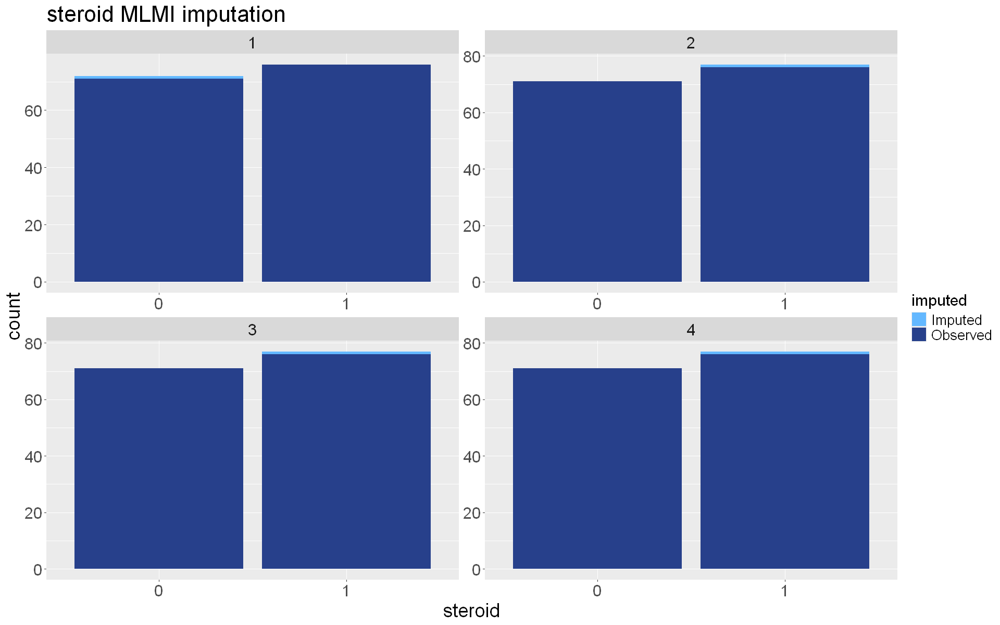

In [43]:
options(repr.plot.width = 16, repr.plot.height = 10)
visImpMulCat(orgtrain, orgtest, imptrain, imptest, "steroid", "MLMI")

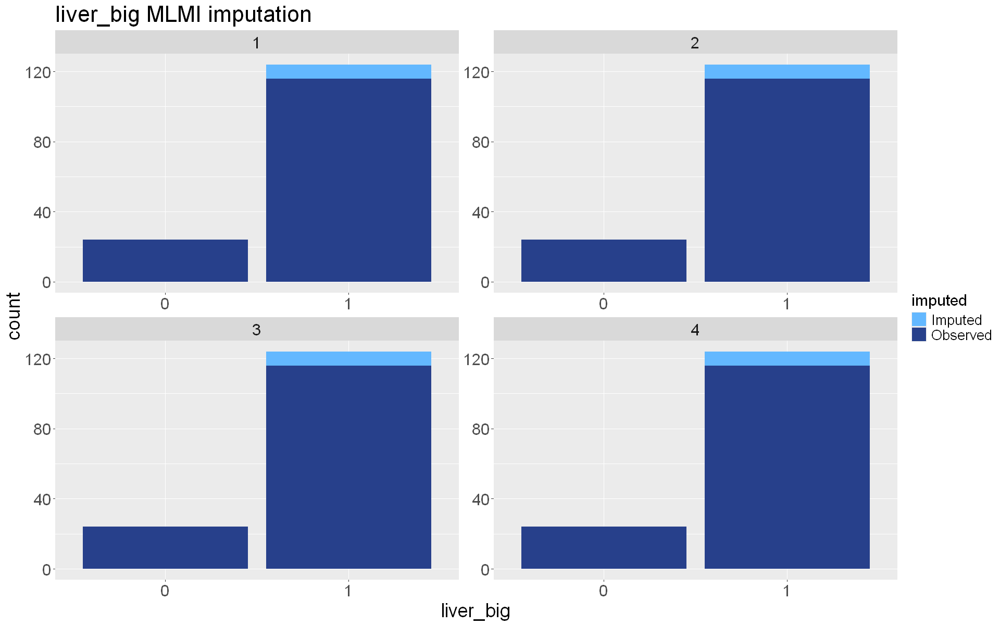

In [44]:
options(repr.plot.width = 16, repr.plot.height = 10)
visImpMulCat(orgtrain, orgtest, imptrain, imptest, "liver_big", "MLMI")

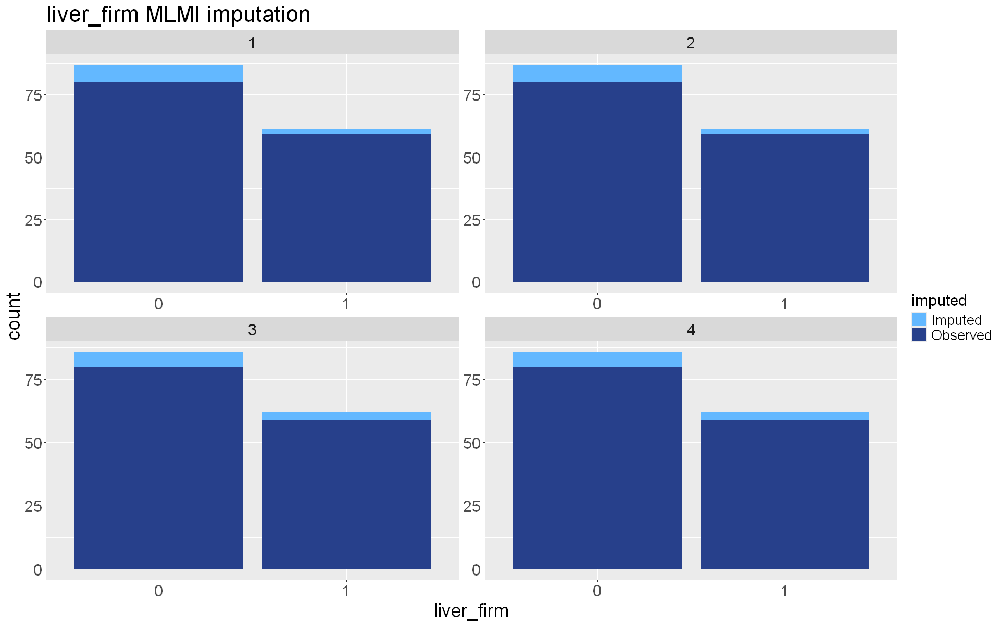

In [45]:
options(repr.plot.width = 16, repr.plot.height = 10)
visImpMulCat(orgtrain, orgtest, imptrain, imptest, "liver_firm", "MLMI")

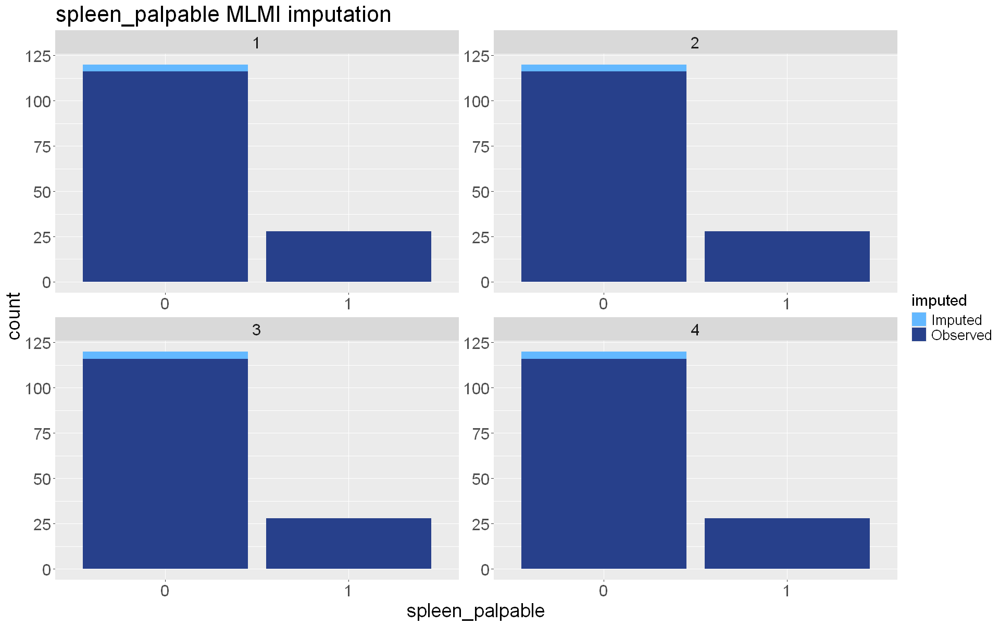

In [46]:
options(repr.plot.width = 16, repr.plot.height = 10)
visImpMulCat(orgtrain, orgtest, imptrain, imptest, "spleen_palpable", "MLMI")

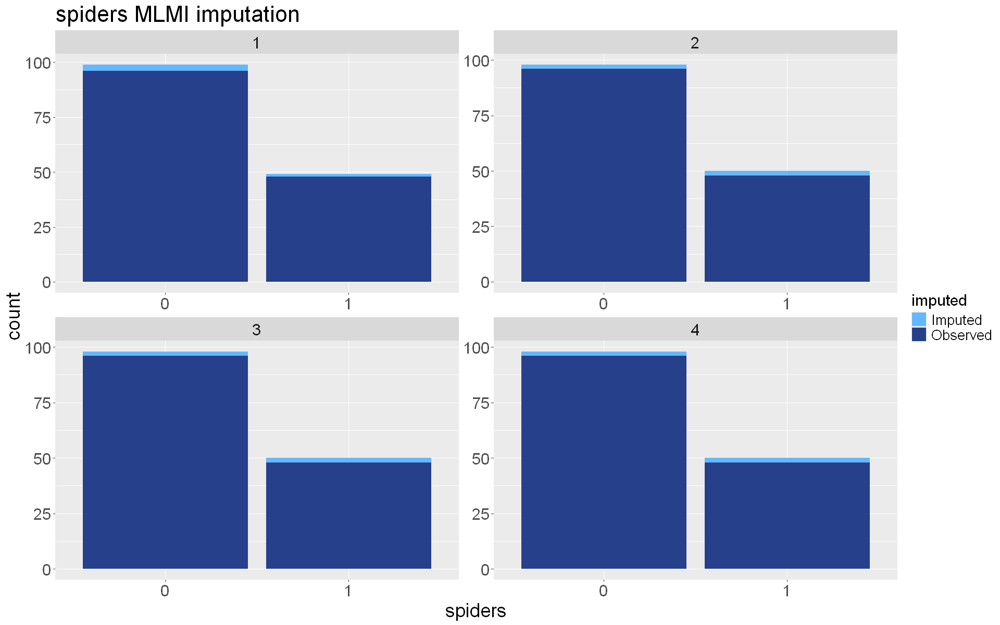

In [47]:
options(repr.plot.width = 16, repr.plot.height = 10)
visImpMulCat(orgtrain, orgtest, imptrain, imptest, "spiders", "MLMI")

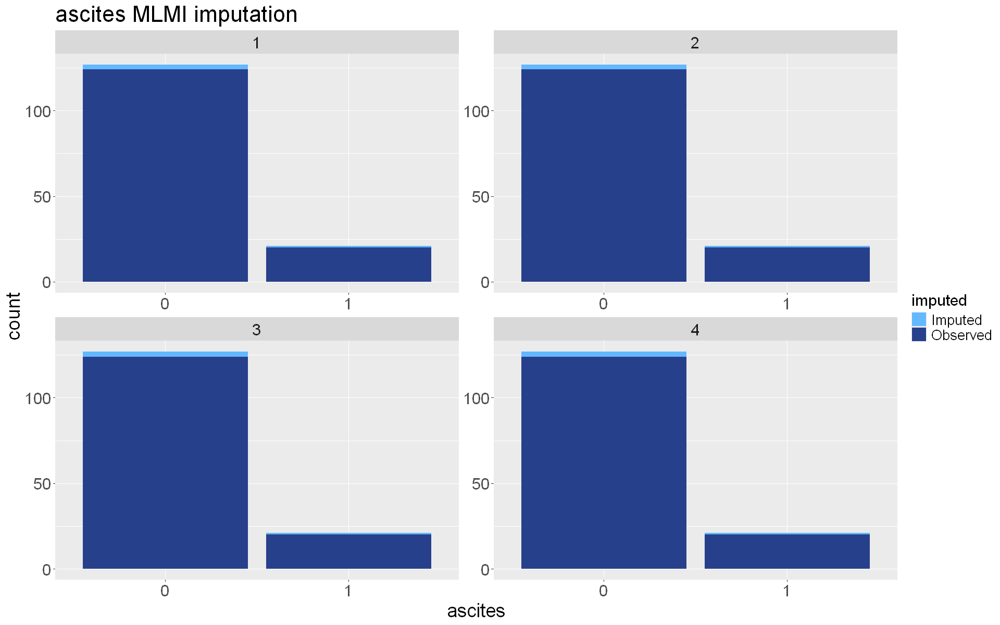

In [48]:
options(repr.plot.width = 16, repr.plot.height = 10)
visImpMulCat(orgtrain, orgtest, imptrain, imptest, "ascites", "MLMI")

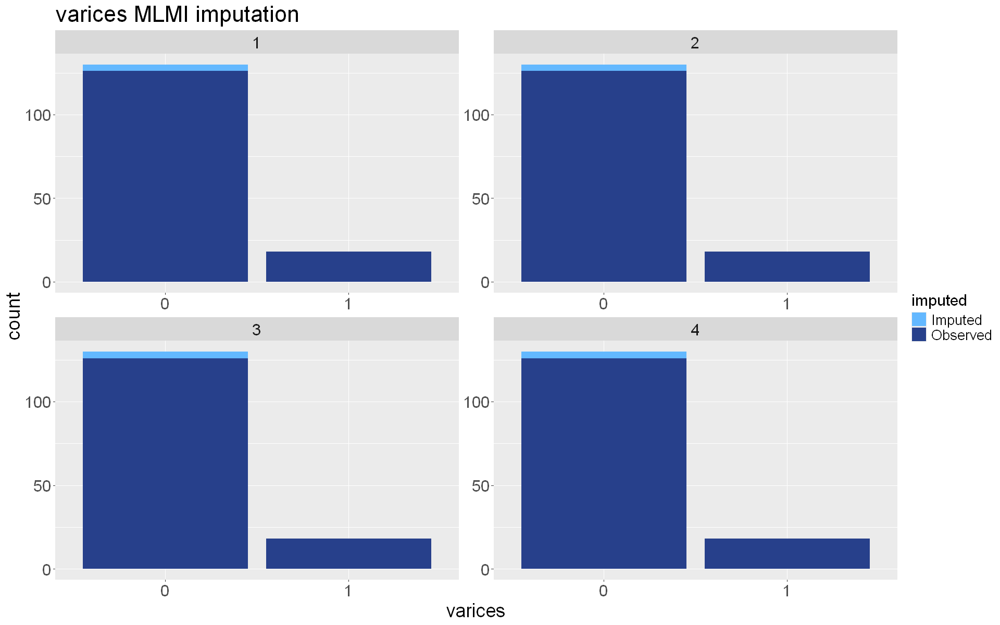

In [49]:
options(repr.plot.width = 16, repr.plot.height = 10)
visImpMulCat(orgtrain, orgtest, imptrain, imptest, "varices", "MLMI")

In [29]:
sim9 <- simulate_mlmi(hep, "die", 100, 5, "mlmi.csv", intcols, fcols2, fcols)

Imputing categorical variables using all 2-way associations.

Imputing continuous variables assuming main effects of categorical variables



Steps of ECM: 
1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...


Imputing categorical variables using all 2-way associations.

Imputing continuous variables assuming main effects of categorical variables



Steps of ECM: 
1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...1

Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message

In [34]:
sim9

V1        V2        V3        V4 
0.7800000 0.7724324 0.7764865 0.8351351

##### Decision tree imputation

In [50]:
train10 <- train
test10 <- test
method10 <- rep("", ncol(hep_vis))
method10[c(2, 7, 8, 9, 10, 11, 12)] <- "cart"

In [51]:
imp_train10 <- mice(train10, method=method10, predictorMatrix=predm, m=1, maxit=1, printFlag=FALSE) %>% complete()

In [52]:
imp_test10 <- mice(test10, method=method10, predictorMatrix=predm, m=1, maxit=1, printFlag=FALSE) %>% complete()

In [53]:
imp_train10[intcols] <- imp_train10[intcols] %>% lapply(as.integer)
imp_test10[intcols] <- imp_test10[intcols] %>% lapply(as.integer)

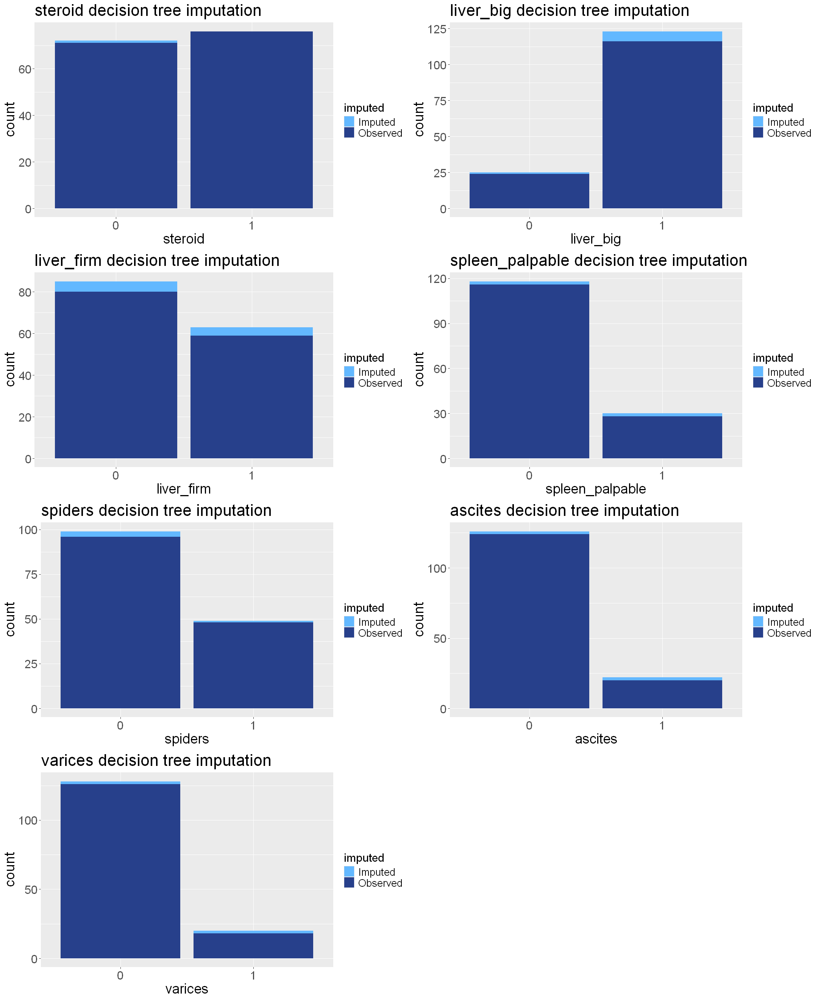

In [54]:
options(repr.plot.width = 18, repr.plot.height = 22)
plt1 <- visImpCat(train10, test10, imp_train10, imp_test10, "steroid", "decision tree")
plt2 <- visImpCat(train10, test10, imp_train10, imp_test10, "liver_big", "decision tree")
plt3 <- visImpCat(train10, test10, imp_train10, imp_test10, "liver_firm", "decision tree")
plt4 <- visImpCat(train10, test10, imp_train10, imp_test10, "spleen_palpable", "decision tree")
plt5 <- visImpCat(train10, test10, imp_train10, imp_test10, "spiders", "decision tree")
plt6 <- visImpCat(train10, test10, imp_train10, imp_test10, "ascites", "decision tree")
plt7 <- visImpCat(train10, test10, imp_train10, imp_test10, "varices", "decision tree")
plot_grid(plt1, plt2, plt3, plt4, plt5, plt6, plt7, ncol = 2)

In [22]:
method10_cls <- rep("", ncol(hep))
method10_cls[c(2, 7, 8, 9, 10, 11, 12)] <- "cart"

In [23]:
sim10 <- simulate(hep, "die", 100, method10_cls, 1, 1, "dt.csv", intcols, fcols2)

Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message

: 

In [26]:
sim10

V1        V2        V3        V4 
0.8188889 0.7758333 0.7691667 0.8427778

##### Random forest imputation

In [55]:
train11 <- train
test11 <- test
method11 <- rep("", ncol(hep_vis))
method11[c(2, 7, 8, 9, 10, 11, 12)] <- "rf"

In [56]:
imp_train11 <- mice(train11, method=method11, predictorMatrix=predm, m=1, maxit=1, printFlag=FALSE) %>% complete()

In [57]:
imp_test11 <- mice(test11, method=method11, predictorMatrix=predm, m=1, maxit=1, printFlag=FALSE) %>% complete()

In [58]:
imp_train11[intcols] <- imp_train11[intcols] %>% lapply(as.integer)
imp_test11[intcols] <- imp_test11[intcols] %>% lapply(as.integer)

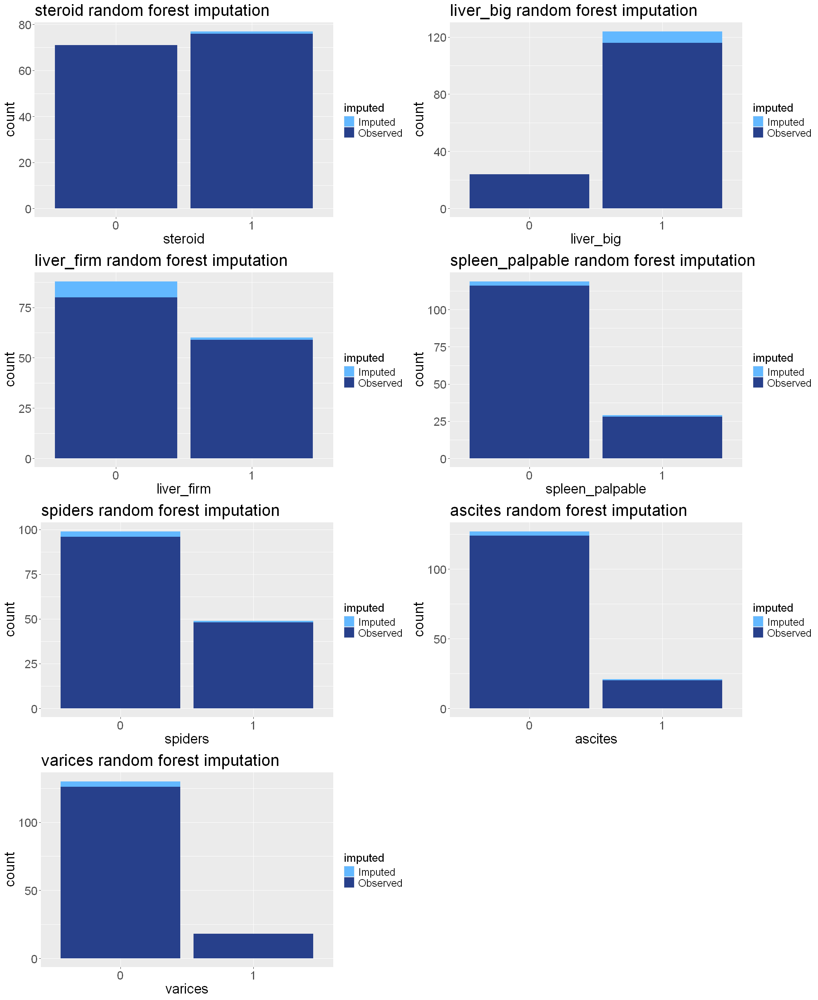

In [59]:
options(repr.plot.width = 18, repr.plot.height = 22)
plt1 <- visImpCat(train11, test11, imp_train11, imp_test11, "steroid", "random forest")
plt2 <- visImpCat(train11, test11, imp_train11, imp_test11, "liver_big", "random forest")
plt3 <- visImpCat(train11, test11, imp_train11, imp_test11, "liver_firm", "random forest")
plt4 <- visImpCat(train11, test11, imp_train11, imp_test11, "spleen_palpable", "random forest")
plt5 <- visImpCat(train11, test11, imp_train11, imp_test11, "spiders", "random forest")
plt6 <- visImpCat(train11, test11, imp_train11, imp_test11, "ascites", "random forest")
plt7 <- visImpCat(train11, test11, imp_train11, imp_test11, "varices", "random forest")
plot_grid(plt1, plt2, plt3, plt4, plt5, plt6, plt7, ncol = 2)

In [ ]:
method11_cls <- rep("", ncol(hep))
method11_cls[c(2, 7, 8, 9, 10, 11, 12)] <- "rf"

In [ ]:
sim11 <- simulate(hep, "die", 100, method11_cls, 1, 1, "rf.csv", intcols, fcols2)

In [28]:
sim11


V1        V2        V3        V4 
0.8155556 0.7747222 0.7611111 0.8338889

In [33]:
accuracies <- as.data.frame(rbind(sim1, sim8, sim9, sim10, sim11))
rownames(accuracies) <- c("Logistic regression", "KNN", "MLMI", "Decision tree", "Random forest")
accuracies

,V1,V2,V3,V4
,<dbl>,<dbl>,<dbl>,<dbl>
Logistic regression,0.8102778,0.7594444,0.7647222,0.8327778
KNN,0.8144444,0.7800000,0.7677778,0.8405556
MLMI,0.8110811,0.7721622,0.7645946,0.8372973
Decision tree,0.8188889,0.7758333,0.7691667,0.8427778
Random forest,0.8155556,0.7747222,0.7611111,0.8338889
